# Proyecto Visualización de Datos Javier Vega - Mg. DS UDD

Dentro de la red de servicios para clientes móviles, tanto de datos como voz (2G,3G,4G,5G), se manejan estadísticas para determinar la calidad del servicio prestado. En este contexto, el indicador de preferencia es el llamado “uptime”, que hace referencia a la cantidad de tiempo que los elementos de red se encuentran disponibles y entregando el servicio. Así, un elemento que se encuentra siempre disponible tiene un 100% de uptime y en caso de fallar, se pondera el tiempo de indisponibilidad para recalcular el indicador. Dichos registros son obtenidos para cada hardware de red y guardados con granularidad diaria en una base de datos administrada por supervisión de redes.

In [47]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import geopandas
import matplotlib.ticker as ticker
import plotly.graph_objects as go
import folium
from scipy.stats import linregress
from shapely.geometry import Point, Polygon

Importamos todas las librerías necesarias para realizar nuestro análisis, posteriormente cargaremos de dataset privado que contiene los registros de UpTime para todos los elementos de red de la operadora en la Región Metropolitana. En este dataset también encontraremos la agrupación por comuna de cada uno de los elementos o antenas.

In [3]:
df_upt=pd.read_csv ('C:/Users/javie/Universidad/Trimestre 2/Visualización de datos/Proyecto Visualización/Raw-Uptime/raw.uptime.2022.csv',sep=",")
df_upt.head(15)

,fecha,semana,sitio,nombre,comuna,tecnologia,avg
0,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0
1,2022-01-01,52.0,14COS,OCHAGAVIA COSITE,El Bosque,3G,100.0
2,2022-01-01,52.0,15COS,LA ESTRELLA COSITE,Pudahuel,3G,100.0
3,2022-01-01,52.0,2NENT,DOS NORTE NEXTEL,La Granja,3G,0.0
4,2022-01-01,52.0,4CENF,CUARTO CENTENARIO,Las Condes,3G,100.0
5,2022-01-01,52.0,5ANUE,5 DE ABRIL ENTEL,Estación Central,3G,100.0
6,2022-01-01,52.0,5DEUM,5 DE ABRIL / LAS REJAS,Estación Central,3G,100.0
7,2022-01-01,52.0,5DFF2,CINCO DE FEBRERO,Cerro Navia,3G,100.0
8,2022-01-01,52.0,A2EN1,ALIMENTOS DOS EN UNO,Las Condes,3G,100.0
9,2022-01-01,52.0,AAANT,AGUAS ANDINAS / ZONA ANTILCO INDOOR,La Granja,3G,0.0


En el siguiente dataset encontraremos la ubicación geográfica (latitud, longitud) de cada uno de los elementos de red, para posteriormente poder utilizar mapas.

In [2]:
df_cor=pd.read_excel ('C:/Users/javie/Universidad/Trimestre 2/Visualización de datos/Proyecto Visualización/Raw-Uptime/Coordenadas Sitios Moviles.xlsx','ALL')
df_cor.head(15)

,sitio,TEC,Vendor/RNC,Celda,Latitud,Longitud
0,TTNF2,3G,UATF1-50,TTNF2U02_2-1,-70.39379,-23.64867
1,TTNF2,3G,UATF1-50,TTNF2U02_8-2,-70.39379,-23.64867
2,ESNO2,3G,UATF1-50,ESNO2U02_1-1,-69.05169,-24.20289
3,ESNO2,3G,UATF1-50,ESNO2U02_7-2,-69.05169,-24.20289
4,ESNO2,3G,UATF1-50,ESNO2U02_2-1,-69.05169,-24.20289
5,ESNO2,3G,UATF1-50,ESNO2U02_8-2,-69.05169,-24.20289
6,ESNO2,3G,UATF1-50,ESNO2U02_3-1,-69.05169,-24.20289
7,ESNO2,3G,UATF1-50,ESNO2U02_9-2,-69.05169,-24.20289
8,TTNF2,3G,UATF1-50,TTNF2U02_1-1,-70.39379,-23.64867
9,TTNF2,3G,UATF1-50,TTNF2U02_3-1,-70.39379,-23.64867


Para llevar un orden adecuado hacemos un merge de ambos dataset.

In [4]:
df_upco = pd.merge(df_upt, df_cor, on='sitio')
df_upco.head(15)

,fecha,semana,sitio,nombre,comuna,tecnologia,avg,TEC,Vendor/RNC,Celda,Latitud,Longitud
0,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPW13_1,-70.61111,-33.42227
1,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPW13_2,-70.61111,-33.42227
2,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPW13_3,-70.61111,-33.42227
3,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPU13_1,-70.61111,-33.42227
4,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPU13_2,-70.61111,-33.42227
5,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPU13_3,-70.61111,-33.42227
6,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPU13_7,-70.61111,-33.42227
7,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPU13_8,-70.61111,-33.42227
8,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,3G,UPDV2-45,11SEPU13_9,-70.61111,-33.42227
9,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,Celdas LTE,NOKIA,11SEPL13_1,-70.61111,-33.42227


Limpiamos el dataset eliminando las columnas que nos son de nuestro interés: Celda, Tec, Vendor/RNC.

In [5]:
df_upco=df_upco.drop(['Celda','TEC','Vendor/RNC'], axis=1)
df_upco.head(15)

,fecha,semana,sitio,nombre,comuna,tecnologia,avg,Latitud,Longitud
0,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
1,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
2,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
3,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
4,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
5,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
6,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
7,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
8,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227
9,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227


Para poder utilizar la librería geopandas realizaremos una transformación del dataset, especificamente de latitud y longitud aun polígono que pueda ser interpretado por el módulo mencionado.

In [6]:
gdf = geopandas.GeoDataFrame(
    df_upco, geometry=geopandas.points_from_xy(df_upco.Longitud, df_upco.Latitud))

print(gdf.head())

        fecha  semana  sitio            nombre       comuna tecnologia    avg  \
0  2022-01-01    52.0  11SEP  11 DE SEPTIEMBRE  Providencia         3G  100.0   
1  2022-01-01    52.0  11SEP  11 DE SEPTIEMBRE  Providencia         3G  100.0   
2  2022-01-01    52.0  11SEP  11 DE SEPTIEMBRE  Providencia         3G  100.0   
3  2022-01-01    52.0  11SEP  11 DE SEPTIEMBRE  Providencia         3G  100.0   
4  2022-01-01    52.0  11SEP  11 DE SEPTIEMBRE  Providencia         3G  100.0   

    Latitud  Longitud                     geometry  
0 -70.61111 -33.42227  POINT (-33.42227 -70.61111)  
1 -70.61111 -33.42227  POINT (-33.42227 -70.61111)  
2 -70.61111 -33.42227  POINT (-33.42227 -70.61111)  
3 -70.61111 -33.42227  POINT (-33.42227 -70.61111)  
4 -70.61111 -33.42227  POINT (-33.42227 -70.61111)  


Posteriormente verificamos el dataset para corroborar que los datatype de todas las columnas están correctamente asignados.

In [7]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 4680259 entries, 0 to 4680258
Data columns (total 10 columns):
 #   Column      Dtype   
---  ------      -----   
 0   fecha       object  
 1   semana      float64 
 2   sitio       object  
 3   nombre      object  
 4   comuna      object  
 5   tecnologia  object  
 6   avg         float64 
 7   Latitud     float64 
 8   Longitud    float64 
 9   geometry    geometry
dtypes: float64(4), geometry(1), object(5)
memory usage: 392.8+ MB


A continuación segmentaremos la fecha en 4 columnas distintas, esto nos facilitará las distintas agrupaciones que queramos realizar para las distintas visualizaciones.

In [8]:
lista_AM = [i.split(" ")[0][:-3] for i in  list(gdf['fecha'])]
lista_A = [i.split(" ")[0][0:4] for i in  list(gdf['fecha'])]
lista_M = [i.split(" ")[0][5:7] for i in  list(gdf['fecha'])]
lista_D = [i.split(" ")[0][8:10] for i in  list(gdf['fecha'])]
gdf['AM'] = lista_AM
gdf['año'] = lista_A
gdf['mes'] = lista_M
gdf['dia'] = lista_D

gdf.head(15)

,fecha,semana,sitio,nombre,comuna,tecnologia,avg,Latitud,Longitud,geometry,AM,año,mes,dia
0,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
1,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
2,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
3,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
4,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
5,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
6,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
7,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
8,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01
9,2022-01-01,52.0,11SEP,11 DE SEPTIEMBRE,Providencia,3G,100.0,-70.61111,-33.42227,POINT (-33.42227 -70.61111),2022-01,2022,01,01


Generamos un nuevo dataset, esta vez agrupado por comuna, fecha y el promedio de UpTime.

In [9]:
gdf_monthly = gdf.groupby(['comuna', 'AM', 'año', 'mes']).mean()
gdf_monthly = gdf_monthly[['avg']].reset_index()

gdf_monthly.head(30)

C:\Users\javie\AppData\Local\Temp\ipykernel_16404\4197382047.py:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  gdf_monthly = gdf.groupby(['comuna', 'AM', 'año', 'mes']).mean()


,comuna,AM,año,mes,avg
0,Alhué,2022-01,2022,01,96.221935
1,Alhué,2022-02,2022,02,98.358095
2,Alhué,2022-03,2022,03,98.336022
3,Alhué,2022-04,2022,04,95.085167
4,Alhué,2022-05,2022,05,99.994946
5,Alhué,2022-06,2022,06,95.579611
6,Alhué,2022-07,2022,07,99.631667
7,Alhué,2022-08,2022,08,99.870376
8,Alhué,2022-09,2022,09,99.940800
9,Buin,2022-01,2022,01,86.969989


Como un primer análisis, graficaremos el comportamiento del indicador de UpTime durante el año 2022. Podemos ver que existe una fuerte tendencia al alza o recuperación desde Marzo en adelante, contando también con un valor mínimo por bajo el 80% en Febrero del 2022.

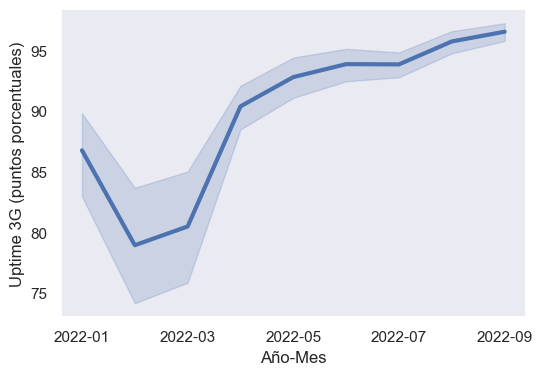

In [232]:
sns.set_style('darkgrid')
sns.set(rc={'figure.figsize':(6,4)})

ax = sns.lineplot(data=gdf_monthly, x ='AM', y = 'avg',
                  lw=3, legend='brief')

ax.xaxis.set_major_locator(ticker.MultipleLocator(2))
ax.grid(False)
plt.ylabel('Uptime 3G (puntos porcentuales)')
plt.xlabel('Año-Mes')
plt.savefig("uptime.png", transparent=True)
plt.show()

Para poder entender mejor el comportamiento del indicador, graficaremos de forma dinámica el UpTime para las distintas comunas, esto nos permitirá reconocer las comunas con más afectación y aquellas que deberían ser foco del análisis.

In [11]:
import plotly.graph_objects as go
comunas= gdf_monthly.comuna
comunas= np.unique(comunas).tolist()
comunas

pal = list(sns.color_palette(palette='viridis', n_colors=len(comunas)).as_hex())

fig = go.Figure()
for d,p in zip(comunas, pal):
    fig.add_trace(go.Scatter(x = gdf_monthly[gdf_monthly['comuna']==d]['AM'],
                             y = gdf_monthly[gdf_monthly['comuna']==d]['avg'],
                             name = d,
                             line_color = p, 
                             fill=None))  

fig.show()

A continuación realizamos el mismo gráfico anterior pero esta vez con una visualización de área.

In [12]:
fig = go.Figure()
for d,p in zip(comunas, pal):
    fig.add_trace(go.Scatter(x = gdf_monthly[gdf_monthly['comuna']==d]['AM'],
                             y = gdf_monthly[gdf_monthly['comuna']==d]['avg'],
                             name = d,
                             line_color = p, 
                             fill='tozeroy'))    

fig.show()

Como pudimos apreciar en los gráficos anteriores y dada la cantidad de comunas es un poco difícil reconocer las tendencias de cada una, por lo que con fines de exploración realizaremos un gráfico por separado para cada una de las comunas.

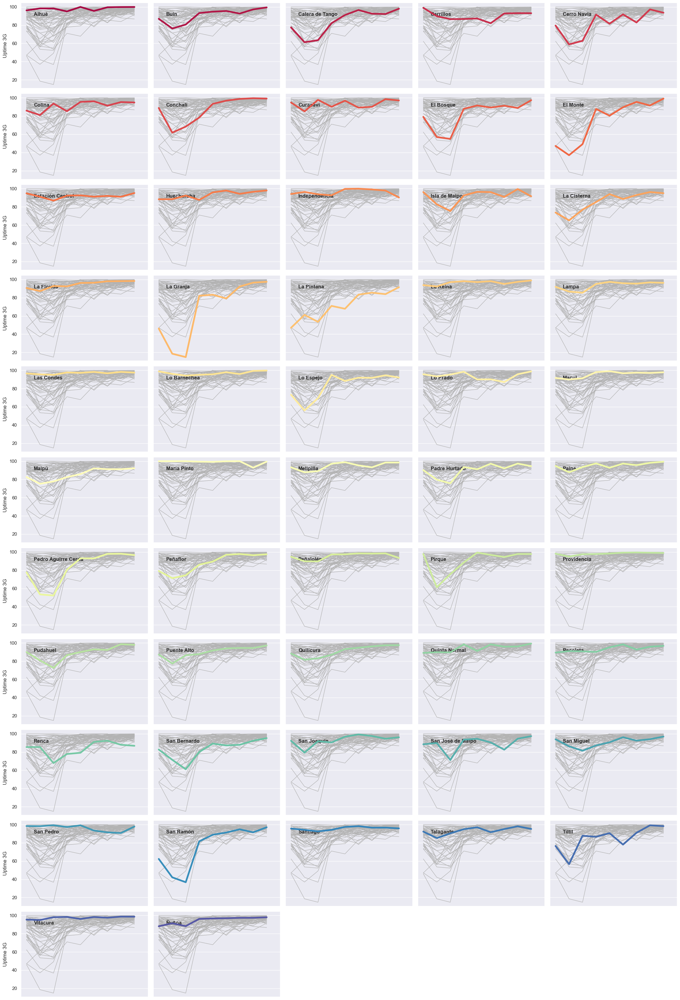

In [13]:
g = sns.relplot(data = gdf_monthly, x = "AM", y = "avg",
                col = "comuna", hue = "comuna",
                kind = "line", palette = "Spectral",   
                linewidth = 4, zorder = 5,
                col_wrap = 5, height = 3, aspect = 1.5, legend = False
               )


for time, ax in g.axes_dict.items():
    ax.text(.1, .85, time,
            transform = ax.transAxes, fontweight="bold"
           )
    sns.lineplot(data = gdf_monthly, x = "AM", y = "avg", units="comuna",
                 estimator = None, color= ".7", linewidth=1, ax=ax
                )

ax.set_xticks('')
g.set_titles("")
g.set_axis_labels("", "Uptime 3G")
g.tight_layout()

Podemos ver que hay comunas que mantienen relativamente estables sus niveles de UpTime, mientras que otras se vieron fuertemente afectadas en el período Enero-Febrero. Para continuar con la exploración y con motivos de encontrar la mejor manera de representar los datos, graficaremos por comuna el indicador en barras.

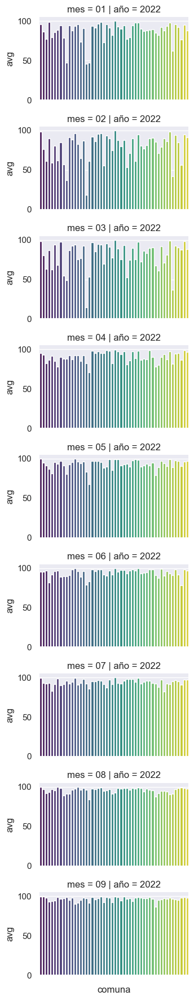

In [14]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

g = sns.FacetGrid(gdf_monthly, col="año", row="mes", height=2, aspect=1.9)
g = g.map(sns.barplot, 'comuna', 'avg', palette='viridis', errorbar=None, order = comunas)

g.set_xticklabels(rotation = 90)
plt.show()

Con miras a una representación de correlación , generamos una tabla pivot del UpTime por comuna y mes.

In [15]:
df_pivot = pd.pivot_table(gdf_monthly,
                          values='avg',
                          index='comuna',
                          columns='AM')
df_pivot

AM,2022-01,2022-02,2022-03,2022-04,2022-05,2022-06,2022-07,2022-08,2022-09
comuna,,,,,,,,,
Alhué,96.221935,98.358095,98.336022,95.085167,99.994946,95.579611,99.631667,99.870376,99.940800
Buin,86.969989,76.286458,80.706100,93.295152,94.797520,95.543655,92.739940,97.267675,99.464496
Calera de Tango,77.503364,61.248653,63.495775,82.148590,91.139744,96.615526,92.587973,92.229715,98.041777
Cerrillos,99.046030,89.873320,86.588778,86.768078,87.299430,82.125505,92.837436,93.149499,93.121506
Cerro Navia,79.581854,58.924787,62.823312,91.606540,81.583335,91.864231,82.943684,97.287016,93.645559
Colina,85.909678,81.019276,93.670485,85.256127,95.470543,96.138343,91.305378,95.291379,94.845511
Conchalí,88.793201,61.730479,68.374663,78.336421,93.295643,96.848822,98.753782,99.504983,99.099783
Curacaví,94.810840,85.080177,97.736343,90.166748,96.807091,89.201203,90.110328,98.497370,97.060013
El Bosque,79.108942,56.931238,54.861879,87.889409,91.526304,89.295109,91.303947,88.822175,97.364062


Con nuestra tabla dinámica lista podemos representar un mapa de calor del indicador para cada una de las comunas a lo largo del tiempo, de esta manera es mucho más fácil identificar las comunas más afectadas de las que tienen un comportamiento normal.

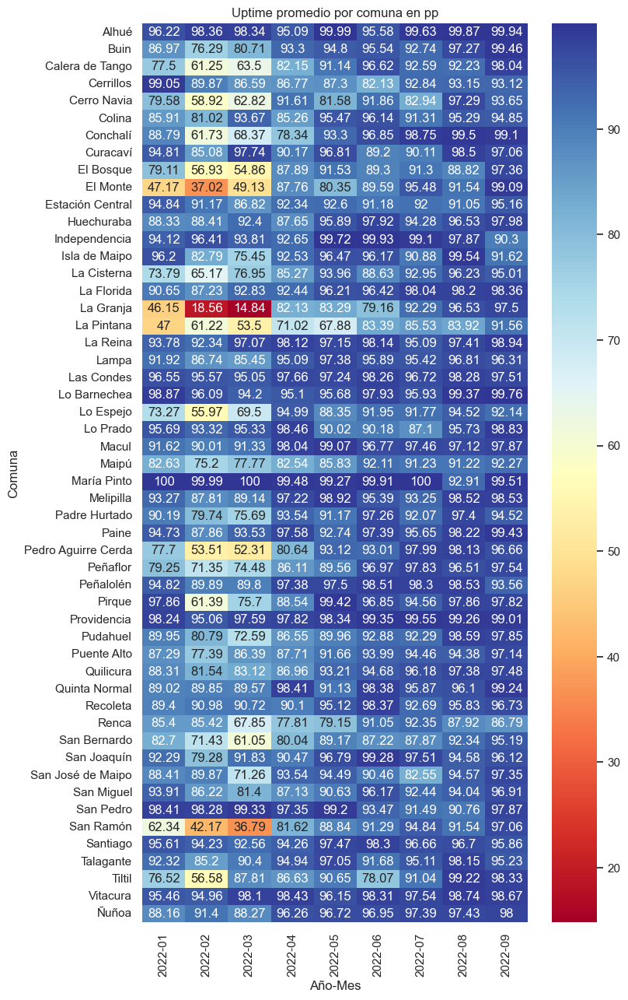

In [16]:
plt.figure(figsize = (8,15))
plt.title('Uptime promedio por comuna en pp')

sns.heatmap(df_pivot, annot=True, cmap='RdYlBu', fmt= '.4g',)
#plt.xlabel('Año-Mes')
#plt.ylabel('Comuna')
plt.show()

Graficamos de forma radial el UpTime por comuna con el fin de encontrar la mejor manera de representar los datos.

In [482]:

import plotly.graph_objects as go


pal = list(sns.color_palette(palette='viridis', n_colors=len(comunas)).as_hex())

months = list(reversed([str(i) for i in list(range(1,10))])) + ['9']
list_PM = [[list(gdf_monthly[gdf_monthly['comuna']==i]['avg'])[int(n)-1] for n in months] for i in comunas]

fig = go.Figure()
for pm,d,c in zip(list_PM, comunas, pal):
    fig.add_trace(go.Scatterpolar(r = pm, theta=months, fill= None,
                                  name=str(d), marker = dict(color = c)))

fig.update_layout(polar = dict(radialaxis = dict(visible = True, range=[0, 100]),
                               angularaxis = dict(rotation=90)),
                  showlegend=True, width=720, height=720,
                  font = dict(size=14))

fig.show()

In [19]:
keep_figname = []
for i in comunas:
    fig = go.Figure()
    for d, pm, c in zip(comunas, list_PM, pal):
        
        
        if i == d:
            fig.add_trace(go.Scatterpolar(r = pm, theta=months, fill='toself',
                                          name=str(d), marker = dict(color = c)))
        else:
            fig.add_trace(go.Scatterpolar(r = pm, theta=months, fill= None,
                                          name=str(d), marker = dict(color = c)))
   
    fig.update_layout(polar = dict(radialaxis = dict(visible = True, range=[0, 100]),
                                   angularaxis = dict(rotation=90)),
                      showlegend = True, width = 720, height = 720,
                      font = dict(size = 14), title = i, title_x = 0.5)
    
    keep_figname.append('radar_'+ i + '.png')
    fig.write_image('radar_'+ i + '.png')   
    fig.show()

A continuación generaremos una representación gráfica de los mismos datos en forma de barra circular.

In [27]:
max_val = max(gdf_monthly['avg'])*1.001       
pal = list(sns.color_palette(palette='YlOrRd', n_colors=len(comunas)).as_hex())

def circular_bar(input_df, column_name, title):
    plt.gcf().set_size_inches(12, 12)
    ax = plt.subplot(projection='polar')
    input_df.reset_index(inplace=True, drop=True)
    for i in range(len(input_df)):
        ax.barh(i, input_df[column_name][i]*2*np.pi/max_val, label=input_df['comuna'][i], color=pal[i])

    ax.set_theta_zero_location('N')
    ax.set_theta_direction(1)
    ax.set_rlabel_position(0)
    ax.set_thetagrids([], labels=[])
    ax.set_rgrids(range(len(input_df)), labels= input_df['comuna'])

    ax = plt.subplot(projection='polar')
    plt.title("Average Uptime // " + title)
    return ax

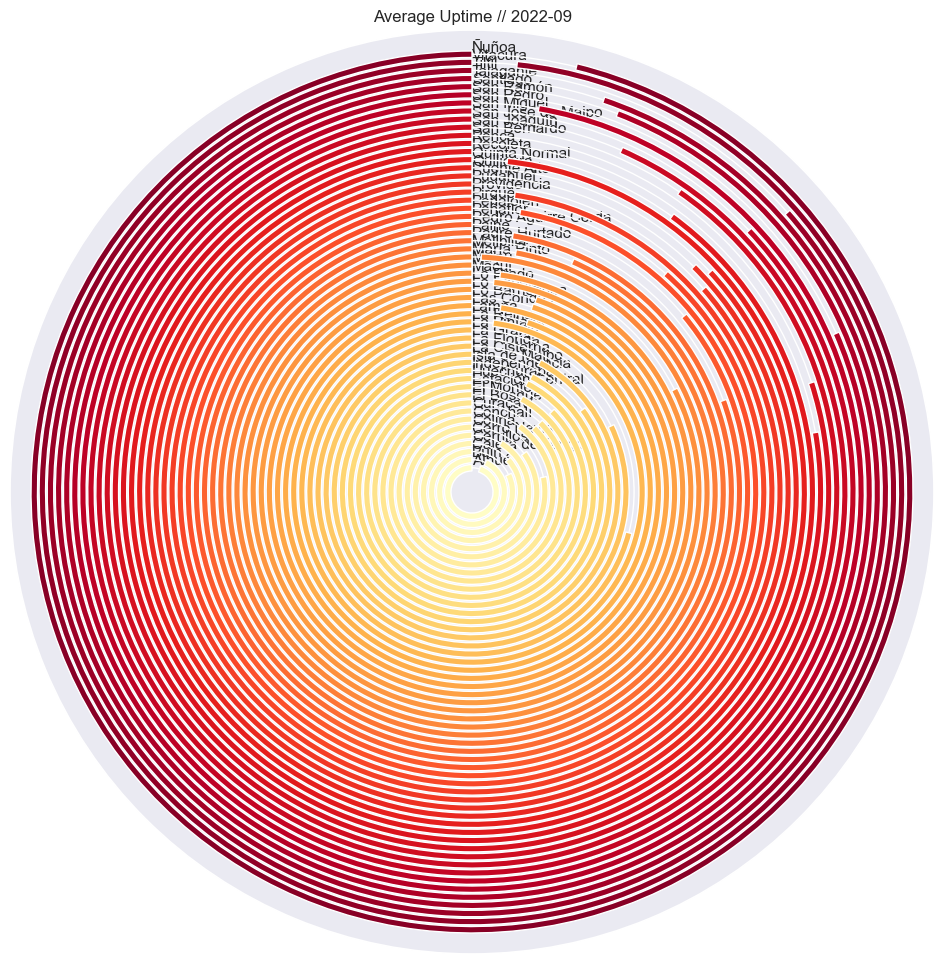

In [28]:
list_month19 = list(set(gdf_monthly['mes']))
list_YM19 = list(set(gdf_monthly['AM']))
list_YM19.sort()
listdf_monthly19 = [gdf_monthly[gdf_monthly['mes']==str(i)] for i in list_month19]

keep_sname = []
order = range(len(listdf_monthly19))

circular_bar(listdf_monthly19[i],'avg', list_YM19[i])
keep_sname.append('cir_bar_' + str(i) + '.png')
plt.savefig('cir_bar_' + str(i) + '.png')
plt.show()

In [239]:

pal = list(sns.color_palette(palette='mako', n_colors=len(comunas)).as_hex())
lowerLimit = 0
max_v = gdf_monthly['avg'].max()

def radial_plot(input_df, column_name, title):
    input_df.reset_index(inplace=True, drop=True)
    plt.figure(figsize=(12,12))
    ax = plt.subplot(111, polar=True)
    plt.axis()
    
    heights = input_df[column_name]
    width = 2*np.pi / len(input_df.index)

    indexes = list(range(1, len(input_df.index)+1))
    angles = [element * width for element in indexes]

    bars = ax.bar(x=angles, height=heights, width=width, bottom=lowerLimit,
                  linewidth=1, edgecolor="white", color=pal)
    
    labelPadding = 2

    for bar, angle, height, label in zip(bars, angles, heights, comunas):
        rotation = np.rad2deg(angle)
        alignment = ""
      
        if angle >= np.pi/2 and angle < 3*np.pi/2:
            alignment = "right"
            rotation = rotation + 180
        else: 
            alignment = "left"

        ax.text(x=angle, y=lowerLimit + bar.get_height() + labelPadding,
                s=label, ha=alignment, va='center', rotation=rotation, 
                rotation_mode="anchor")
    
        ax.set_thetagrids([], labels=[])
        
    return ax

Generamos otra variante gráfica de los mismos datos.

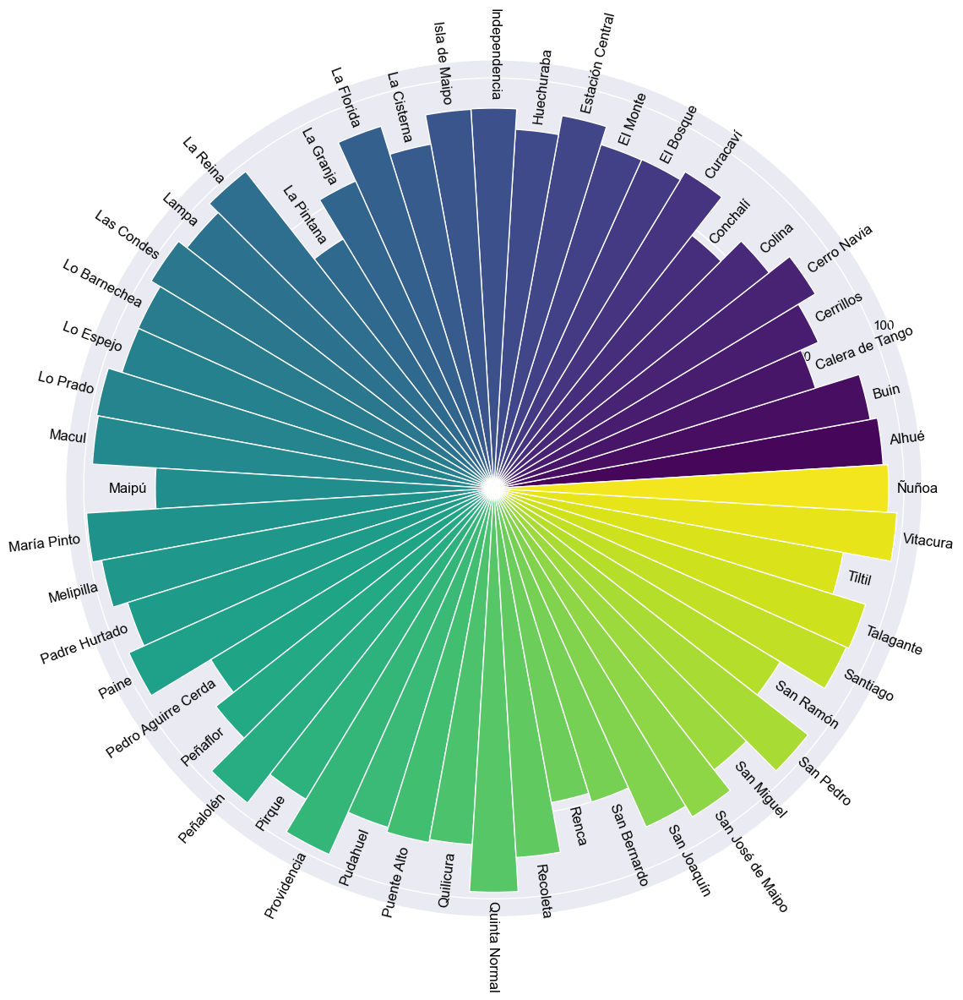

In [483]:
keep_sname = []
order = range(len(listdf_monthly19))

#for i in order:
radial_plot(listdf_monthly19[i], 'avg', list_YM19[i])
keep_sname.append('rad_bar_' + str(i) + '.png')
plt.savefig('rad_bar_' + str(i) + '.png',transparent=True)
plt.show()

In [237]:

pal = list(sns.color_palette(palette='viridis', n_colors=len(list_month19)).as_hex())

def kde_ridge(df_input, col_name, time, title):
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    
    g = sns.FacetGrid(df_input, row= time, hue=time, aspect=15, height=0.65, palette=pal)

    
    g.map(sns.kdeplot, col_name,
          bw_adjust=.5, clip_on=False,fill=True, alpha=1, linewidth=1.5)

    g.map(sns.kdeplot, col_name, clip_on=False, color="w", lw=2, bw_adjust=.5)

    
    g.map(plt.axhline, y=0, linewidth=2, linestyle="-", color=None, clip_on=False)
    
    def label(x, color, label):
        ax = plt.gca()
        ax.text(0, .2, label, fontweight="bold", color=color,ha="left", va="center", transform=ax.transAxes)
    
    g.map(label, time)

    
    g.fig.subplots_adjust(hspace=-.25)

    
    g.set_titles("")
    g.set(yticks=[], ylabel="", xlabel= title + ' Uptime')
    g.despine(bottom=True, left=True)

    return g

A continuación generaremos un nuevo set de datos y listas para poder visualizar la cantidad de sitios o antenas que tienen determinados valores de UpTime a lo largo del tiempo y así poder ver su comportamiento por grupos de comunas o comunas en particular.

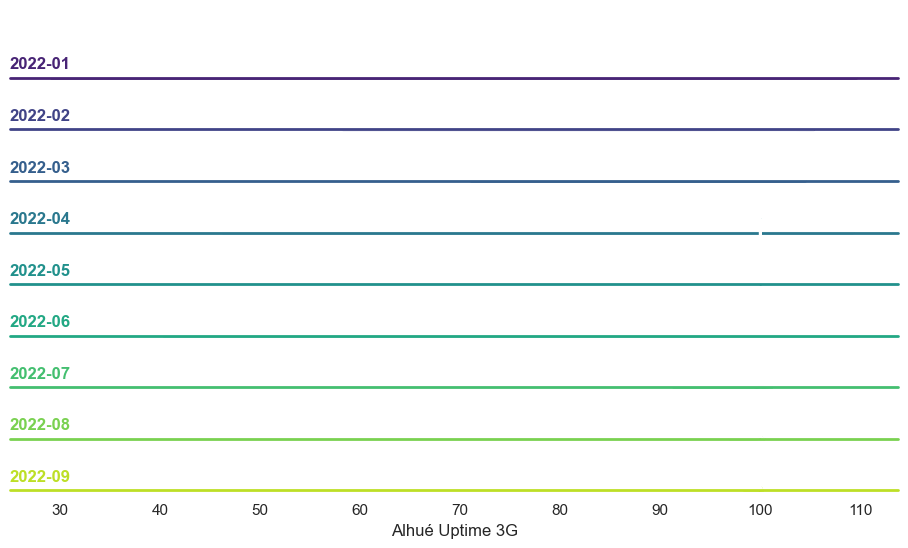

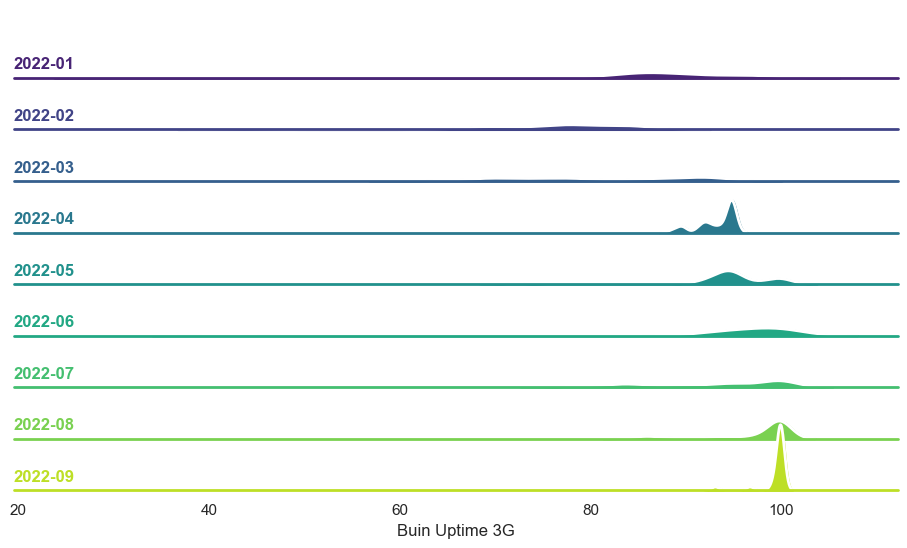

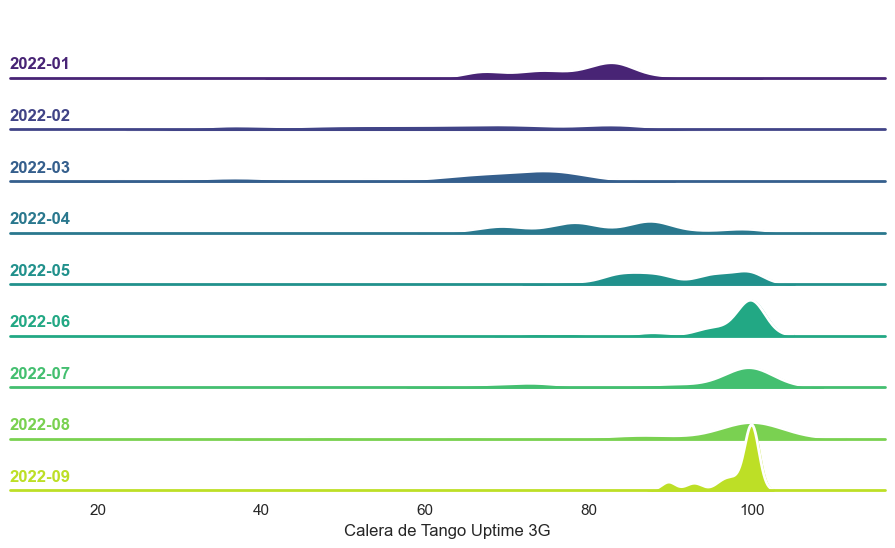

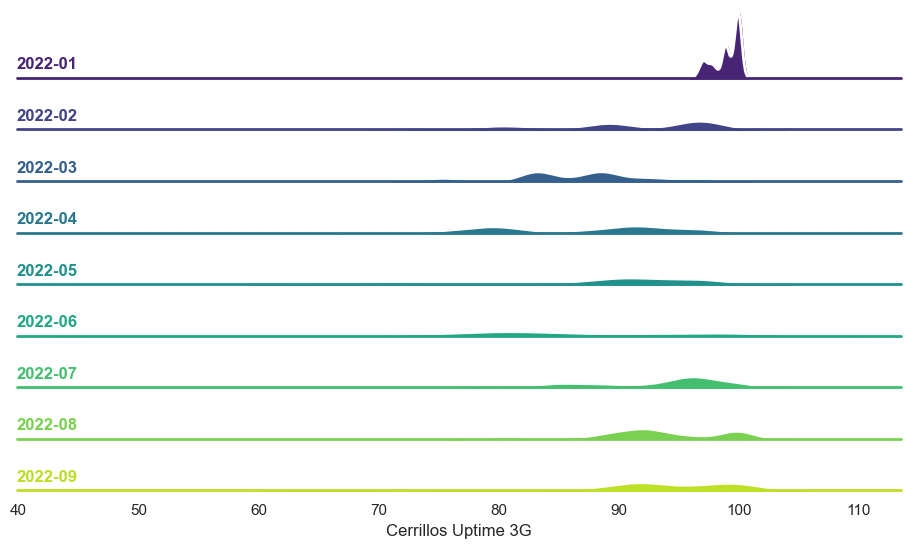

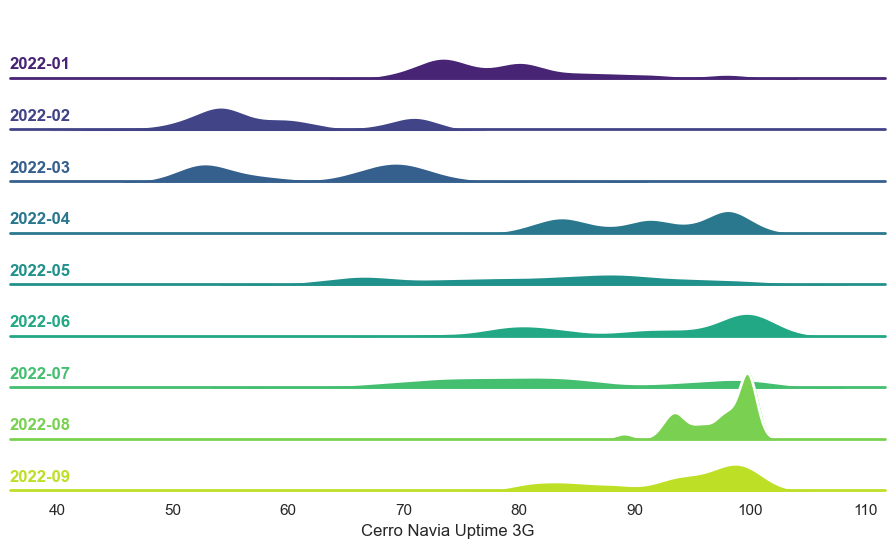

...

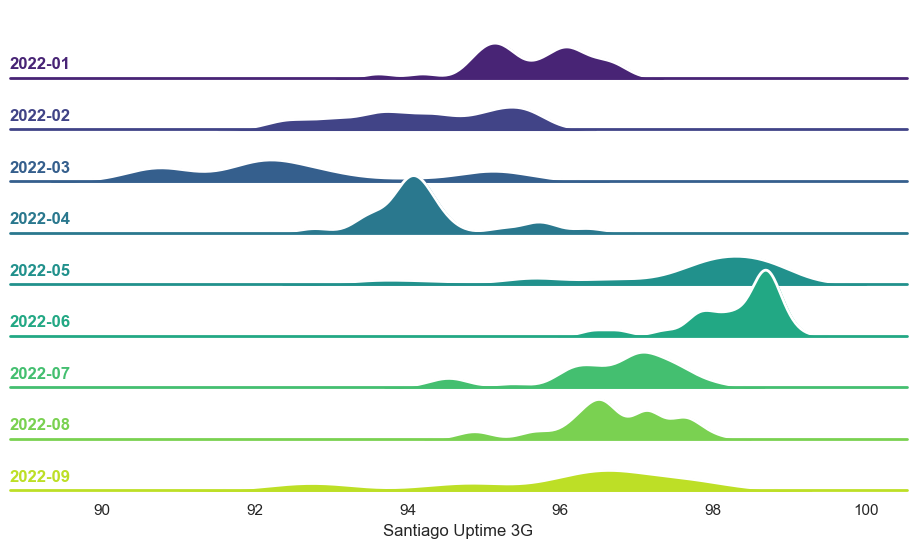

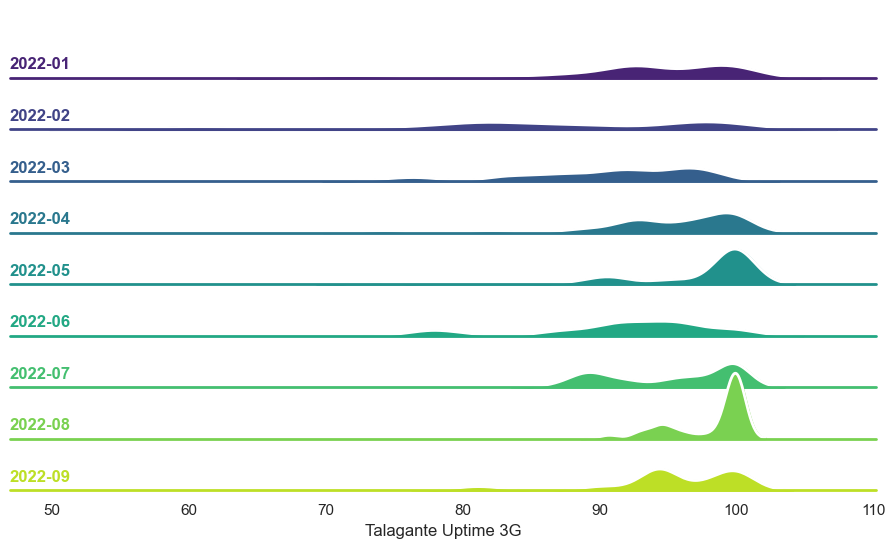

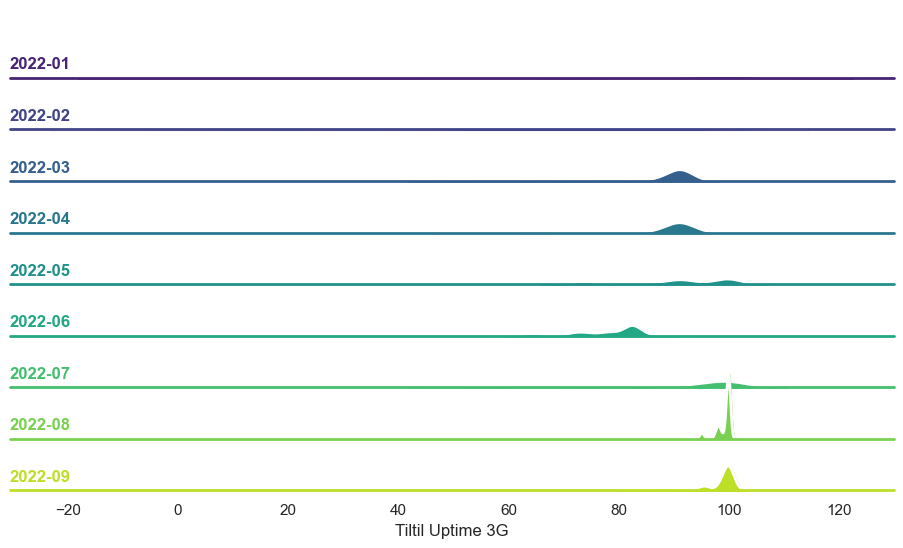

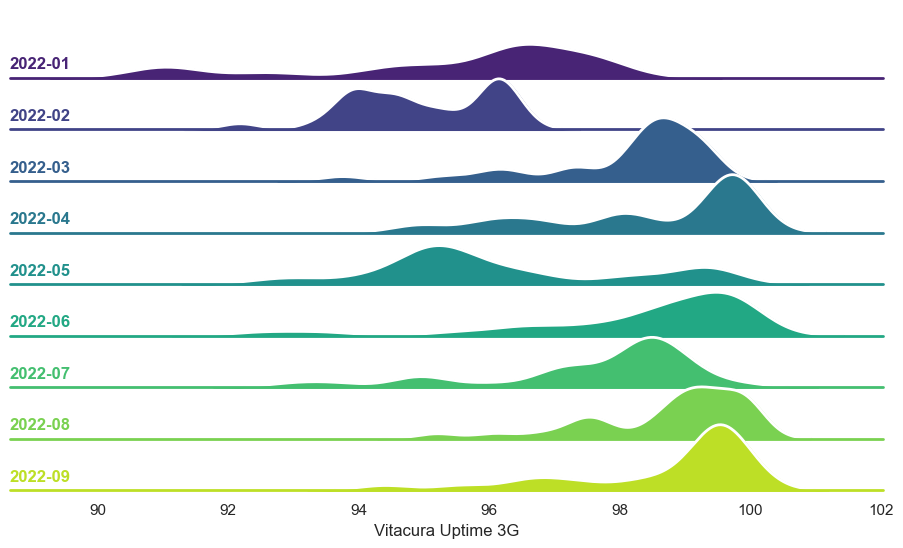

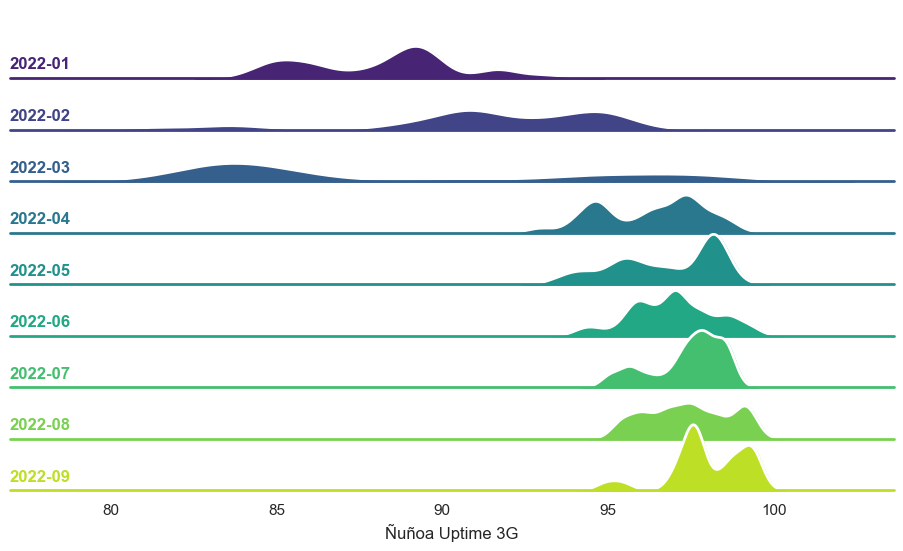

In [238]:

df_hd19 = [gdf_day[gdf_day['comuna']==i] for i in comunas]

keep_sname = []
order = range(len(comunas))
for i in order:
    kde_ridge(df_hd19[i], 'avg', 'AM', comunas[i])
    keep_sname.append('kde_' + str(i) + '.png')
    plt.savefig('kde_' + str(i) + '.png', transparent=True)
    plt.show()

Ya conseguidas algunas visualizaciones y de cara a poder establecer otro tipo de relaciones generaremos un nuevo dataset, esta vez por día.

In [42]:
gdf_day = gdf.groupby(['comuna', 'AM', 'año', 'mes','dia']).mean()
gdf_day = gdf_day[['avg']].reset_index()

gdf_day.head(30)

,comuna,AM,año,mes,dia,avg
0,Alhué,2022-01,2022,01,01,99.976667
1,Alhué,2022-01,2022,01,02,100.000000
2,Alhué,2022-01,2022,01,03,100.000000
3,Alhué,2022-01,2022,01,04,99.993333
4,Alhué,2022-01,2022,01,05,100.000000
5,Alhué,2022-01,2022,01,06,99.993333
6,Alhué,2022-01,2022,01,07,71.850000
7,Alhué,2022-01,2022,01,08,38.660000
8,Alhué,2022-01,2022,01,09,100.000000
9,Alhué,2022-01,2022,01,10,72.493333


Ahora, para poder interactuar con los datos de localización cargaremos los archivos shape desde limitaciones para zonas urbanas desde la página oficial de la Biblioteca del Congreso Nacional (BCN).

In [408]:
sf_path = "C:/Users/javie/Universidad/Trimestre 2/Visualización de datos/Proyecto Visualización/L/lu.shp"
sf = geopandas.read_file(sf_path, encoding='utf-8')
sf.head(100)
stgo_sf = sf[sf.REGION == '13']
stgo_shape = stgo_sf.to_crs({'init': 'epsg:4326'})
stgo_shape


,FID,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,TIPO,CODIGO_CAT,CATEGORIA,Shape__Are,Shape__Len,geometry
121,122,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,PAINE,CAPITAL COMUNAL,1,CIUDAD,7.914834e+06,17793.646475,"POLYGON ((-70.73797 -33.79851, -70.73738 -33.7..."
122,123,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,HUELQUÉN,URBANO,2,PUEBLO,3.053472e+06,20488.963662,"POLYGON ((-70.64840 -33.81521, -70.64859 -33.8..."
123,124,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,HOSPITAL,URBANO,1,CIUDAD,6.642026e+06,17333.663301,"POLYGON ((-70.76468 -33.84349, -70.76448 -33.8..."
124,125,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,PINTUÉ - LA GUACHERA,URBANO,2,PUEBLO,4.355833e+06,18179.078840,"POLYGON ((-70.87824 -33.86540, -70.87839 -33.8..."
125,126,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,EL TRÁNSITO,URBANO,2,PUEBLO,9.777246e+05,9511.271637,"POLYGON ((-70.65834 -33.78357, -70.65832 -33.7..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
219,220,13,REGIÓN METROPOLITANA DE SANTIAGO,136,TALAGANTE,13602,EL MONTE,EL MONTE,CAPITAL COMUNAL,1,CIUDAD,1.880755e+07,28217.161075,"POLYGON ((-70.99282 -33.67260, -70.99282 -33.6..."
220,221,13,REGIÓN METROPOLITANA DE SANTIAGO,136,TALAGANTE,13601,TALAGANTE,TALAGANTE,CAPITAL PROVINCIAL,1,CIUDAD,1.500422e+07,23840.504179,"POLYGON ((-70.92714 -33.64912, -70.92705 -33.6..."
221,222,13,REGIÓN METROPOLITANA DE SANTIAGO,136,TALAGANTE,13601,TALAGANTE,EL ROTO CHILENO,URBANO,2,PUEBLO,3.231334e+05,3611.941090,"POLYGON ((-70.83494 -33.66122, -70.83443 -33.6..."
222,223,13,REGIÓN METROPOLITANA DE SANTIAGO,136,TALAGANTE,13601,TALAGANTE,LONQUÉN,URBANO,2,PUEBLO,2.920640e+05,3503.678026,"POLYGON ((-70.85226 -33.71130, -70.85154 -33.7..."


Generamos una nueva tabla pivot, esta vez para poder visualizar todos los elementos de red o antenas en un mapa.

In [434]:
df_sitios = gdf.groupby(['comuna', 'sitio', 'Latitud','Longitud']).mean()
df_sitios = df_sitios[['avg']].reset_index()

df_sitios = geopandas.GeoDataFrame(
    df_sitios, geometry=geopandas.points_from_xy(df_sitios.Latitud, df_sitios.Longitud))



Generamos 2 gráficas distintas que nos permitan comparar la posición de las antenas con la delimitación por comuna de la región metropolitana, aquí podemos apreciar que en el gráfico de puntos la forma de la Región Metropolitana es facilmente apreciable a pesar de no tener delimitaciones, lo tomamos en consideración ya que nos podría ser muy útil más adelante.

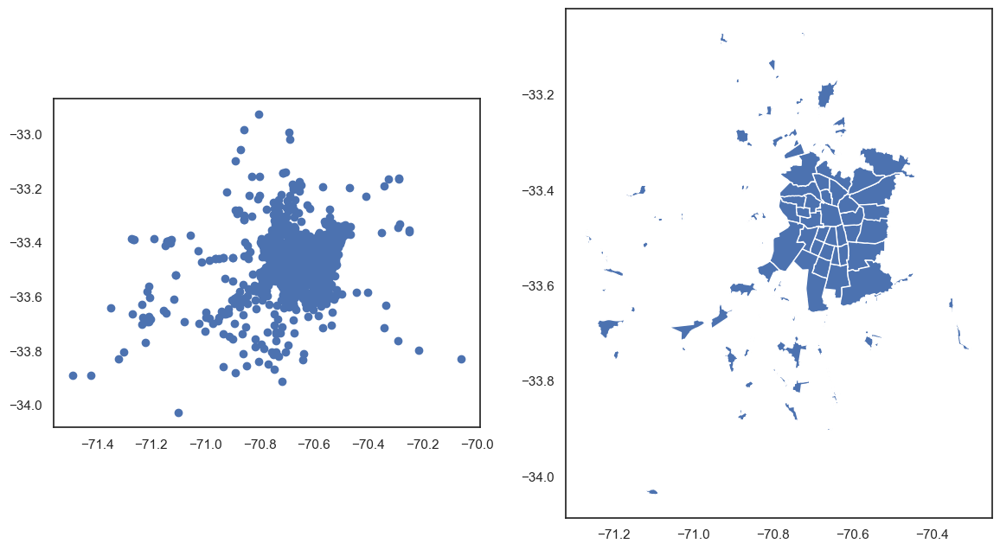

In [111]:
fig, ax = plt.subplots(1,2, figsize=(14,8))

df_sitios.plot(ax=ax[0])
stgo_shape.plot(ax=ax[1])

plt.show()

Esta vez graficamos los puntos por sobre los polígonos de la zona urbana de la Región Metropolitana.

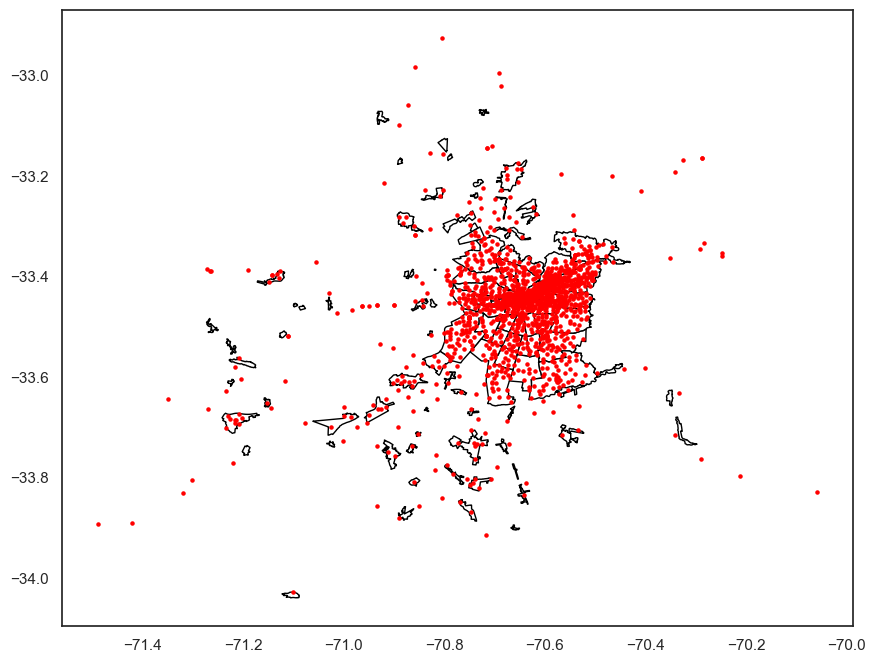

In [113]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()

ax.set_aspect('equal')

stgo_shape.plot(ax=ax, color='white', edgecolor='black')
 

df_sitios.plot(ax=ax, marker='o', color='red', markersize=5)


plt.show();

A contianuación le daremos un vistazo al módulo folium, que nos permite trabajar con mapas directamente, superpondremos los puntos de ubicación de los elementos de red. Nos damos cuenta que se le hace un tanto pesado al módulo interpretar tantos elementos, por lo que quizás no sea la mejor idea utilizarlo.

In [109]:
import folium


m = folium.Map(location=[20,0], tiles="OpenStreetMap", zoom_start=2)
for i in range(0,len(df_sitios)):
   folium.Marker(
      location=[df_sitios.iloc[i]['Longitud'], df_sitios.iloc[i]['Latitud']],
      popup=df_sitios.iloc[i]['sitio'],
   ).add_to(m)


m

A continuación generamos un mapa de calor.

<GeoAxesSubplot: >

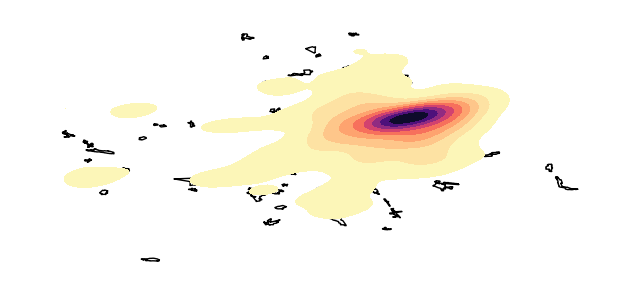

In [135]:

import geoplot
import geoplot.crs as gcrs



ax = geoplot.kdeplot(df_sitios, cmap='magma_r', shade=True,
                     projection=gcrs.AlbersEqualArea())

geoplot.polyplot(stgo_shape, ax=ax)

Hasta ahora hemos explorado el indicador de UpTime sin considerar otras variables que pudieran afectarlo, para enriquecer el análisis incorporaremos los datos de hechos delictivos registrados durante el primer semestre de 2022, según el Centro de Estudios y Análisis del Delito (CEAD). El motivo de esto es poder encontrar relaciones entre el deterioro del indicador y el aumento de delincuencia en ciertas comunas de la Región Metropolitana. En particular, a causa del robo de cables de cobre.

Importante destacar que este delito no se encuentra tipificado de ninguna forma en la base del CEAD, por lo que se tomó en consideración el espectro más grande de delito que se puede filtrar sin tomar en consideración ilegalidades que puedan quedar fuera del objeto de estudio (delitos sexuales, violencia intrafamiliar, homicidios, etc.).

http://cead.spd.gov.cl/estadisticas-delictuales/#descargarExcel

In [151]:
df_delito=pd.read_excel ('C:/Users/javie/Universidad/Trimestre 2/Visualización de datos/Proyecto Visualización/delitos.xlsx')
df_delito.head(15)
df_delito.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312 entries, 0 to 311
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   fecha    312 non-null    datetime64[ns]
 1   comuna   312 non-null    object        
 2   delitos  312 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 7.4+ KB


Convertimos la fecha del formato datetype a object para poder trabajar con los dataset anteriores.

In [152]:
df_delito['fecha'] = df_delito['fecha'].dt.strftime('%Y-%m-%d')

Separamos la fecha en columnas y agrupamos el dataset por comuna con la cantidad de delitos.

In [153]:
df_delito.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 312 entries, 0 to 311
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   fecha    312 non-null    object
 1   comuna   312 non-null    object
 2   delitos  312 non-null    int64 
dtypes: int64(1), object(2)
memory usage: 7.4+ KB


In [163]:
lista_AM1 = [i.split(" ")[0][:-3] for i in  list(df_delito['fecha'])]
df_delito['AM'] = lista_AM1
del df_delito['fecha']
df_delito

In [274]:
df45=df_delito.groupby(['comuna']).mean()
df45=df45.reset_index()

df45.sort_values(by='delitos', ascending=False)

,comuna,delitos
47,Santiago,3167.500000
36,Puente Alto,1578.833333
25,Maipú,1381.333333
15,La Florida,1213.666667
41,San Bernardo,1153.666667
34,Providencia,1083.666667
10,Estación Central,859.166667
39,Recoleta,831.000000
20,Las Condes,771.000000
35,Pudahuel,755.166667


Como podemos ver las 5 comunas con más hechos delictuales registrados son: Santiago, San Bernardo, Puente Alto, La Florida y Maipú. Generaremos un nuevo dataset sólo con estás 5 comunas, que serán el objeto del análisis.

In [276]:
df_topdelito = df_delito[df_delito.comuna.isin(['Santiago', 'San Bernardo', 'Puente Alto', 'La Florida','Maipú'])]
df_topdelito

,comuna,delitos,AM
0,Santiago,3109,2022-01
9,La Florida,1149,2022-01
18,Maipú,1186,2022-01
32,Puente Alto,1585,2022-01
38,San Bernardo,1118,2022-01
52,Santiago,3025,2022-02
61,La Florida,1037,2022-02
70,Maipú,1130,2022-02
84,Puente Alto,1320,2022-02
90,San Bernardo,939,2022-02


Ahora volveremos al dataset de polígonos para filtrar las columnas de interés y poder demarcarlas en la gráfica.

In [431]:
stgo_shape['color'] = ['1' if (x=='13401') or (x=='13101') or (x=='13110') or (x=='13201') or (x=='13119') else 'Otros' for x in stgo_shape.COMUNA]

stgo_shape.head(100)

,FID,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,URBANO,TIPO,CODIGO_CAT,CATEGORIA,Shape__Are,Shape__Len,geometry,color
121,122,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,PAINE,CAPITAL COMUNAL,1,CIUDAD,7.914834e+06,17793.646475,"POLYGON ((-70.73797 -33.79851, -70.73738 -33.7...",Otros
122,123,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,HUELQUÉN,URBANO,2,PUEBLO,3.053472e+06,20488.963662,"POLYGON ((-70.64840 -33.81521, -70.64859 -33.8...",Otros
123,124,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,HOSPITAL,URBANO,1,CIUDAD,6.642026e+06,17333.663301,"POLYGON ((-70.76468 -33.84349, -70.76448 -33.8...",Otros
124,125,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,PINTUÉ - LA GUACHERA,URBANO,2,PUEBLO,4.355833e+06,18179.078840,"POLYGON ((-70.87824 -33.86540, -70.87839 -33.8...",Otros
125,126,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,EL TRÁNSITO,URBANO,2,PUEBLO,9.777246e+05,9511.271637,"POLYGON ((-70.65834 -33.78357, -70.65832 -33.7...",Otros
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
216,217,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13130,SAN MIGUEL,SAN MIGUEL,CAPITAL COMUNAL,1,CIUDAD,1.386381e+07,16029.803899,"POLYGON ((-70.64197 -33.47650, -70.64191 -33.4...",Otros
217,218,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13131,SAN RAMÓN,SAN RAMÓN,CAPITAL COMUNAL,1,CIUDAD,9.061336e+06,14097.960667,"POLYGON ((-70.63742 -33.51877, -70.63723 -33.5...",Otros
218,219,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13101,SANTIAGO,SANTIAGO,CAPITAL REGIONAL,1,CIUDAD,3.332991e+07,29265.433463,"POLYGON ((-70.66560 -33.42810, -70.66457 -33.4...",1
219,220,13,REGIÓN METROPOLITANA DE SANTIAGO,136,TALAGANTE,13602,EL MONTE,EL MONTE,CAPITAL COMUNAL,1,CIUDAD,1.880755e+07,28217.161075,"POLYGON ((-70.99282 -33.67260, -70.99282 -33.6...",Otros


Generamos un nuevo dataframe agrupando los delitos por fecha.

In [277]:
df_topdelito2 = df_topdelito.groupby(['AM']).mean()
df_topdelito2 = df_topdelito2['delitos'].reset_index()
df_topdelito2

,AM,delitos
0,2022-01,1629.4
1,2022-02,1490.2
2,2022-03,1916.2
3,2022-04,1718.8
4,2022-05,1776.0
5,2022-06,1663.4


Finalmente hacemos un merge generando un dataframe final por la comuna, fecha mes y UpTime/Delitos Promedio.

In [278]:
df_final = pd.merge(gdf_monthly, df_delito, on=['AM','comuna'])
df_final.head(15)
del df_final['año']
del df_final['mes']
df_final

,comuna,AM,avg,delitos
0,Alhué,2022-01,96.221935,28
1,Alhué,2022-02,98.358095,19
2,Alhué,2022-03,98.336022,15
3,Alhué,2022-04,95.085167,10
4,Alhué,2022-05,99.994946,14
...,...,...,...,...
307,Ñuñoa,2022-02,91.395610,607
308,Ñuñoa,2022-03,88.274459,756
309,Ñuñoa,2022-04,96.262745,809
310,Ñuñoa,2022-05,96.722523,843


Generamos otro dataset solamente con agrupación por fecha.

In [279]:
df_final2 = df_final.groupby(['AM']).mean()
df_final2 = df_final2.reset_index()
df_final2

,AM,avg,delitos
0,2022-01,86.770881,485.288462
1,2022-02,78.939598,430.884615
2,2022-03,80.486502,559.057692
3,2022-04,90.400395,514.038462
4,2022-05,92.816277,535.980769
5,2022-06,93.884878,503.307692


In [300]:
df_final3 = df_final2[df_final2.AM.isin(['2022-01','2022-02','2022-03', '2022-04', '2022-05', '2022-06'])]
df_final3

,AM,avg,delitos
0,2022-01,86.770881,485.288462
1,2022-02,78.939598,430.884615
2,2022-03,80.486502,559.057692
3,2022-04,90.400395,514.038462
4,2022-05,92.816277,535.980769
5,2022-06,93.884878,503.307692


Graficamos la cantidad de delitos durante el primer semestre del 2022.

C:\Users\javie\AppData\Local\Temp\ipykernel_16404\2943057135.py:4: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
C:\Users\javie\AppData\Roaming\Python\Python310\site-packages\IPython\core\pylabtools.py:151: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



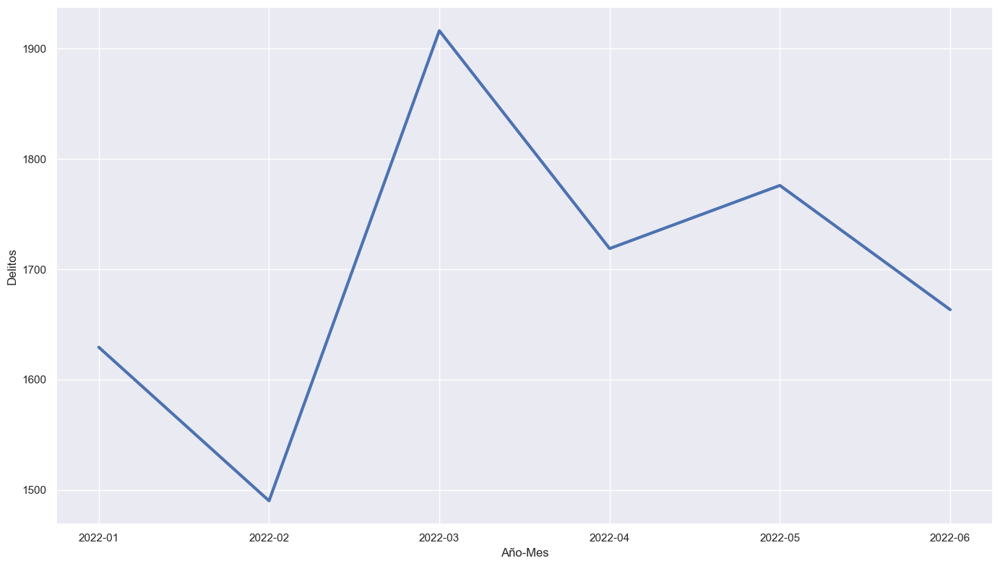

In [485]:
sns.set_style('darkgrid')
sns.set(rc={'figure.figsize':(14,8)})

ax = sns.lineplot(data=df_topdelito2, x ='AM', y = 'delitos',
                 palette='viridis',
                  legend='full', lw=3)

ax.xaxis.set_major_locator(ticker.MultipleLocator(1))
plt.legend(bbox_to_anchor=(1, 1))
plt.ylabel('Delitos')
plt.xlabel('Año-Mes')
plt.show()

Ahora, graficamos la tendencia de delitos con el UpTime Promedio.

<AxesSubplot: >

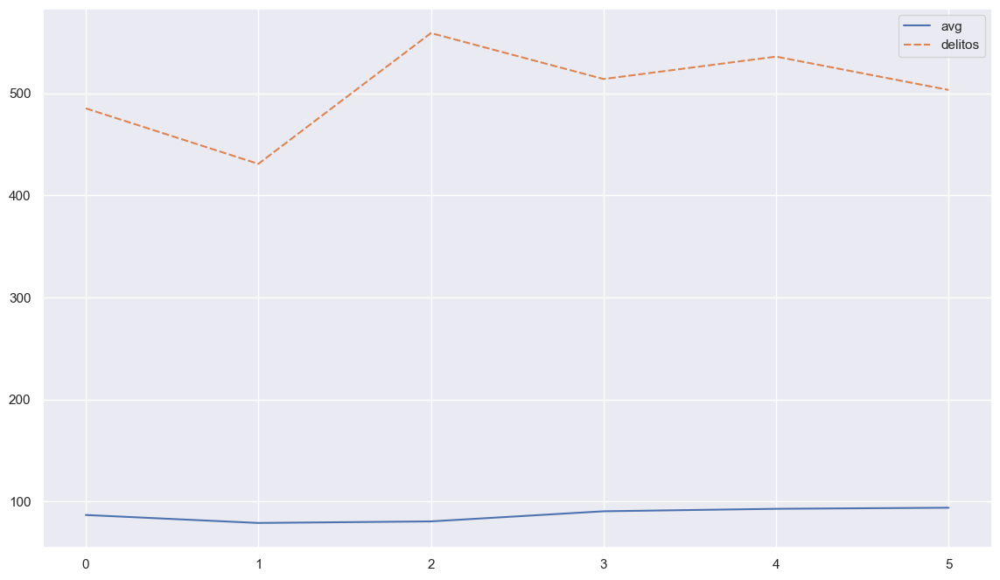

In [282]:
sns.lineplot(data=df_final2)

In [283]:
df_uptime_top = gdf_monthly[gdf_monthly.comuna.isin(['Santiago', 'San Bernardo', 'Puente Alto', 'La Florida','Maipú'])]
df_uptime_top

,comuna,AM,año,mes,avg
135,La Florida,2022-01,2022,01,90.651512
136,La Florida,2022-02,2022,02,87.234649
137,La Florida,2022-03,2022,03,92.828525
138,La Florida,2022-04,2022,04,92.435074
139,La Florida,2022-05,2022,05,96.214927
140,La Florida,2022-06,2022,06,96.417638
141,La Florida,2022-07,2022,07,98.044541
142,La Florida,2022-08,2022,08,98.204428
143,La Florida,2022-09,2022,09,98.361645
225,Maipú,2022-01,2022,01,82.627683


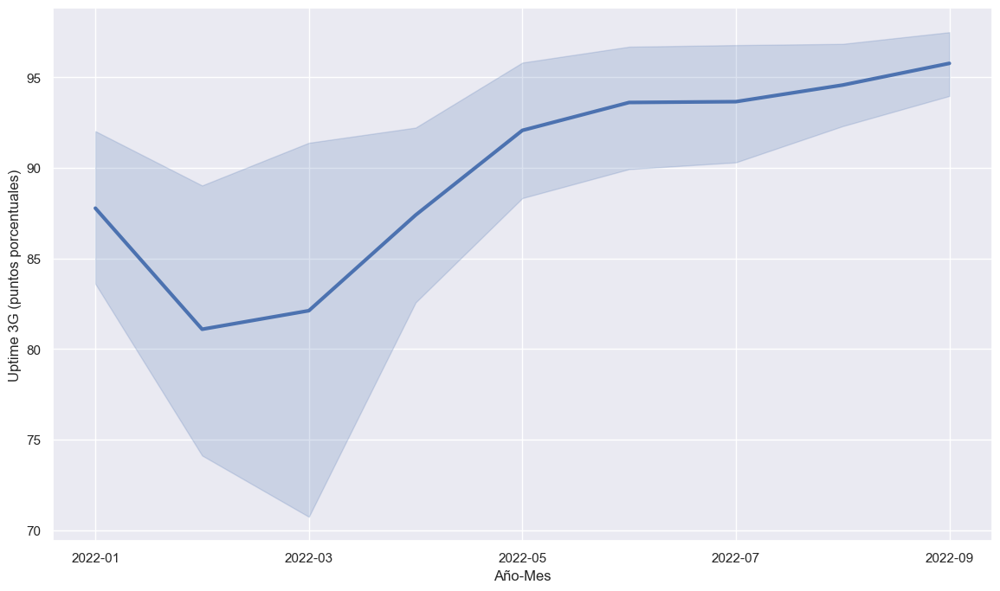

In [284]:
sns.set_style('darkgrid')
sns.set(rc={'figure.figsize':(14,8)})

ax = sns.lineplot(data=df_uptime_top, x ='AM', y = 'avg',
                  lw=3, legend='brief')

ax.xaxis.set_major_locator(ticker.MultipleLocator(2))

plt.ylabel('Uptime 3G (puntos porcentuales)')
plt.xlabel('Año-Mes')
plt.show()

Dado que la visualización anterior de ambas variables no era buena, generamos un segundo eje y para poder revisar las tendencias de mejor manera. Nos damos cuenta entonces que existe un quiebre importante durante el mes de Marzo del año 2022 a partir del cual se produce un aumento súbito en los hechos delictuales y se alcanzan valores de UpTime muy bajos, por consiguiente en los siguientes períodos el UpTime tiende a recuperarse a medida que los hechos delictuales van a la baja.

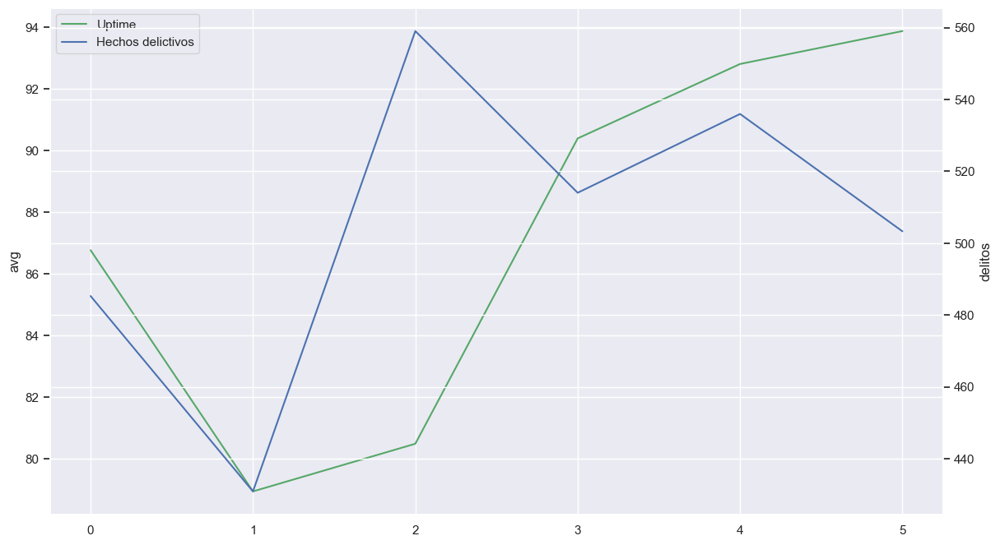

In [312]:
from matplotlib.lines import Line2D
    
g = sns.lineplot(data=df_final3.avg, color="g")
sns.lineplot(data=df_final3.delitos, color="b", ax=g.axes.twinx())
g.legend(handles=[Line2D([], [], color="g", label='Uptime'), Line2D([], [], color="b", label='Hechos delictivos')])

Generamos una matriz de correlación entre ambas variables.

C:\Users\javie\AppData\Roaming\Python\Python310\site-packages\IPython\core\events.py:89: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



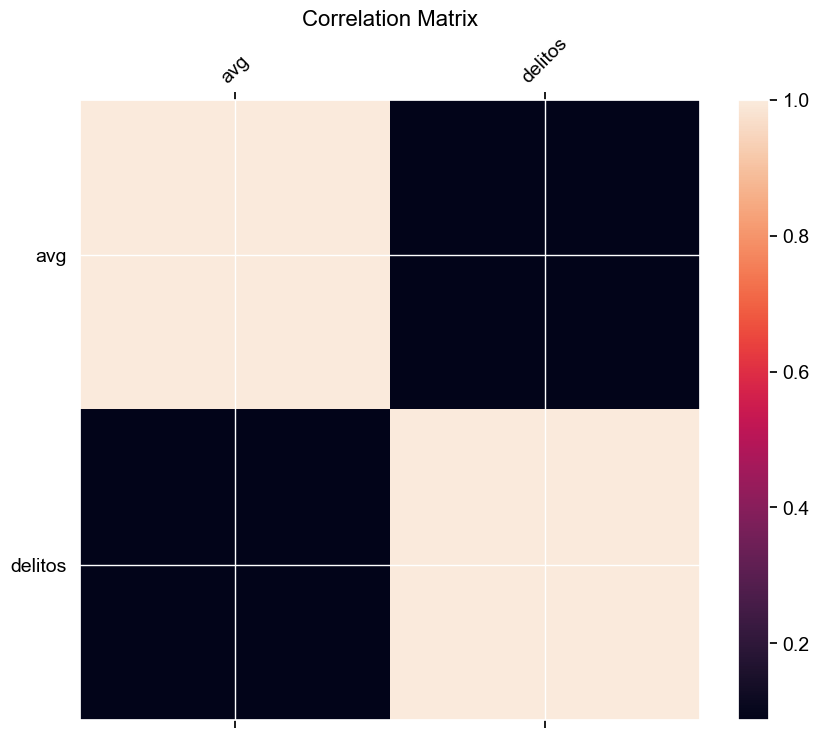

In [481]:
f = plt.figure(figsize=(10, 8))
plt.matshow(df_final.corr(), fignum=f.number)
plt.xticks(range(df_final.select_dtypes(['number']).shape[1]), df_final.select_dtypes(['number']).columns, fontsize=14, rotation=45)
plt.yticks(range(df_final.select_dtypes(['number']).shape[1]), df_final.select_dtypes(['number']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

A continuación generamos un gráfico de radar para poder visualizar mejor la cantidad de hechos delictuales para el Top 5 de las comunas.

In [299]:
import plotly.graph_objects as go
comunas2= df_topdelito.comuna
comunas2= np.unique(comunas2).tolist()
comunas2

pal = list(sns.color_palette(palette='viridis', n_colors=len(comunas2)).as_hex())

months = list(reversed([str(i) for i in list(range(1,7))])) + ['6']
list_PM = [[list(df_topdelito[df_topdelito['comuna']==i]['delitos'])[int(n)-1] for n in months] for i in comunas2]

fig = go.Figure()
for pm,d,c in zip(list_PM, comunas2, pal):
    fig.add_trace(go.Scatterpolar(r = pm, theta=months, fill= None,
                                  name=str(d), marker = dict(color = c)))

fig.update_layout(polar = dict(radialaxis = dict(visible = True, range=[1000, 4000]),
                               angularaxis = dict(rotation=90)),
                  showlegend=True, width=600, height=500,
                  font = dict(size=14))
fig.write_image('robo.png')
fig.show()


Exploramos la tendencia dentro del dataframe de delito

<AxesSubplot: >

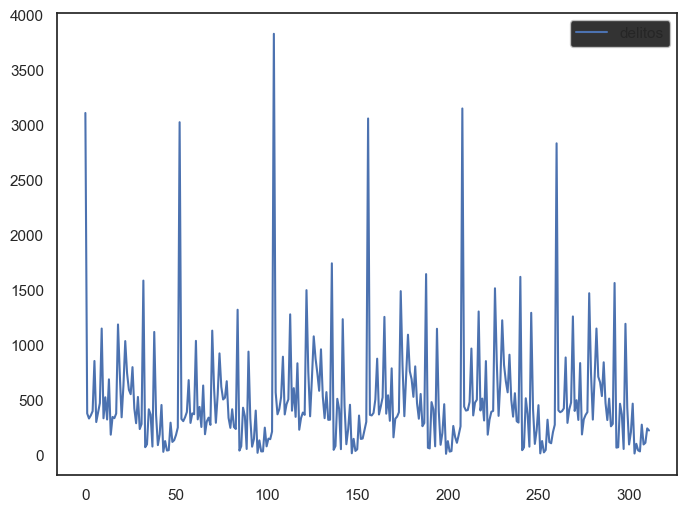

In [261]:
df_delito.plot()

In [269]:
import plotly.graph_objects as go
comunas3= df_delito.comuna
comunas3= np.unique(comunas3).tolist()
comunas3

pal = list(sns.color_palette(palette='viridis', n_colors=len(comunas3)).as_hex())

months = list(reversed([str(i) for i in list(range(1,7))])) + ['6']
list_PM = [[list(df_delito[df_delito['comuna']==i]['delitos'])[int(n)-1] for n in months] for i in comunas3]

fig = go.Figure()
for pm,d,c in zip(list_PM, comunas3, pal):
    fig.add_trace(go.Scatterpolar(r = pm, theta=months, fill= None,
                                  name=str(d), marker = dict(color = c)))

fig.update_layout(polar = dict(radialaxis = dict(visible = True, range=[0, 4000]),
                               angularaxis = dict(rotation=90)),
                  showlegend=True, width=720, height=720,
                  font = dict(size=14))
fig.write_image('radar_'+ i + '.png',transparent=True)
fig.show()

<Figure size 800x600 with 0 Axes>

Paso siguiente, graficamos la relación que existe entre las variables de UpTime y delitos promedio. Nos damos cuenta que existe una tendencia en que a mayor UpTime, menor es la cantidad de delitos registrados.

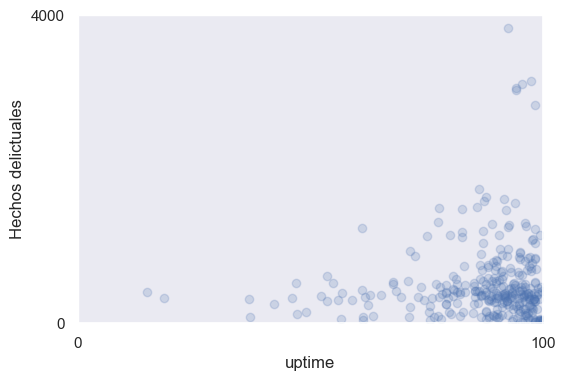

In [353]:
ax=sns.regplot(x = "avg", y="delitos", data=df_final, fit_reg = False, scatter_kws={"alpha": 0.2})

sns.set(rc={'figure.figsize':(7,5),'legend.frameon':False} )

sns.axes_style({'text.color': 'white','ytick.color': 'white','axes.labelcolor': 'white'})


mini=[0]
maxi=[100]
maxi1=[4000]
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
#ax.grid(False)
#plt.box(on=None)

plt.ylabel('Hechos delictuales')
plt.xlabel('uptime')
plt.xlim(min(mini),max(maxi))
plt.ylim(min(mini),max(maxi1))
plt.xticks(np.linspace(0, 100, 2))  # arbitrary chosen
plt.yticks(np.linspace(0,4000, 2))
plt.savefig("relacion2.png", transparent=True)
plt.show()

Corroboramos la relación, esta vez incorporando la tendencia de cada eje por separado.

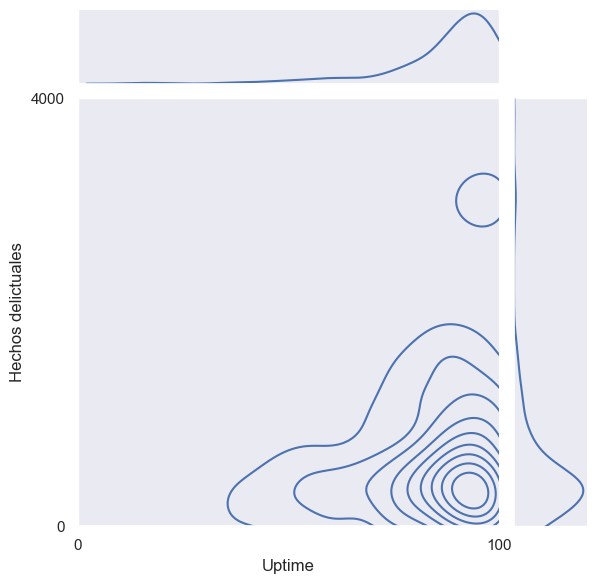

In [352]:
ax=sns.jointplot(x = "avg", y="delitos", data=df_final, kind = 'kde')
sns.set_style('darkgrid')
sns.set(rc={'figure.figsize':(6,4)})

mini=[0]
maxi=[100]
maxi1=[4000]

plt.ylabel('Hechos delictuales')
plt.xlabel('Uptime')
plt.savefig("relacion1.png", transparent=True)
plt.xlim(min(mini),max(maxi))
plt.ylim(min(mini),max(maxi1))
plt.xticks(np.linspace(0, 100, 2))  
plt.yticks(np.linspace(0,4000, 2))
plt.show()

In [ ]:
sns.FacetGrid(df_final, col="comuna").map(plt.scatter, "avg", "delitos", alpha = 1).add_legend()

A continuación generamos un mapa de calor con los valores de UpTime para poder compararlos posteriormente con el Top 5 de comunas con más hechos delictivos.

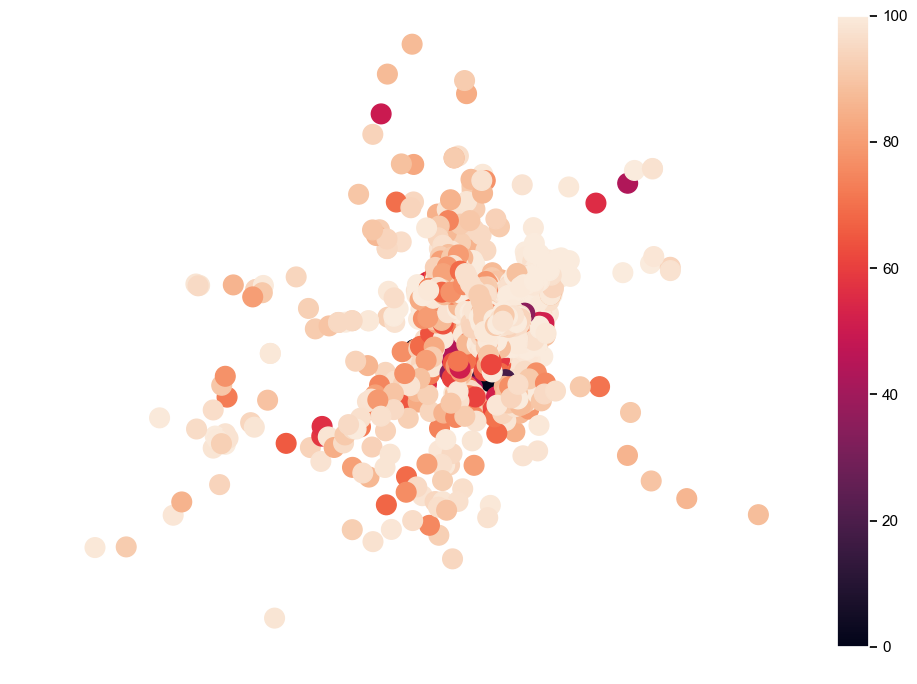

In [470]:
import numpy as np
import matplotlib.pyplot as plt

x = df_sitios['Latitud'].ravel()
y = df_sitios['Longitud'].ravel()
c = df_sitios['avg'].ravel()
ax.grid(False)
plt.box(on=None)

COLOR = 'white'
mpl.rcParams['text.color'] = 'black'
mpl.rcParams['axes.labelcolor'] = 'black'
mpl.rcParams['xtick.color'] = 'black'
mpl.rcParams['ytick.color'] = 'black'

plt.rcParams["figure.figsize"] = (10,7)
plt.scatter(x, y, c=c, s=200)
plt.colorbar()
plt.savefig("heatmap.png", transparent=True)
plt.show()

Graficamos en el mapa las comunas seleccionadas para darnos cuenta que se relacionan fuertemente con el mapa de calor y los valores más bajos de UpTime en las distintas zonas de la Región Metropolitana. Junto con las correlaciones anteriores este análsisi culmina exponiendo tendencias que nos hacen pensar que existe una relación que puede llegar a ser medida entre la frecuencia de los hechos delictuales y los indicadores de calidad de servicio de red.

In [448]:
stgo_shape.explore(column='color', cmap=['red', 'blue'])

In [476]:
df_sitios2=df_sitios
df_sitios2

,comuna,sitio,Latitud,Longitud,avg,geometry
0,Alhué,ALHUE,-71.10167,-34.02681,98.090274,POINT (-71.10167 -34.02681)
1,Buin,ALTJA,-70.72444,-33.73297,93.811312,POINT (-70.72444 -33.73297)
2,Buin,BMATT,-70.74733,-33.70553,98.665796,POINT (-70.74733 -33.70553)
3,Buin,BUCDE,-70.73953,-33.73665,98.086915,POINT (-70.73953 -33.73665)
4,Buin,BUIC1,-70.73499,-33.73320,99.072326,POINT (-70.73499 -33.73320)
...,...,...,...,...,...,...
2099,Ñuñoa,SBOC2,-70.58649,-33.44663,97.414073,POINT (-70.58649 -33.44663)
2100,Ñuñoa,SEUGF,-70.62056,-33.46314,99.960154,POINT (-70.62056 -33.46314)
2101,Ñuñoa,SUCC1,-70.59948,-33.44821,99.998650,POINT (-70.59948 -33.44821)
2102,Ñuñoa,SUPDV,-70.60684,-33.44568,90.875267,POINT (-70.60684 -33.44568)


In [479]:
df_sitios2['delito']= df45.comuna.map(df45.set_index(df45.comuna)['delitos'])
df_sitios2


,comuna,sitio,Latitud,Longitud,avg,geometry,delito
0,Alhué,ALHUE,-71.10167,-34.02681,98.090274,POINT (-71.10167 -34.02681),16.500000
1,Buin,ALTJA,-70.72444,-33.73297,93.811312,POINT (-70.72444 -33.73297),398.000000
2,Buin,BMATT,-70.74733,-33.70553,98.665796,POINT (-70.74733 -33.70553),91.333333
3,Buin,BUCDE,-70.73953,-33.73665,98.086915,POINT (-70.73953 -33.73665),413.333333
4,Buin,BUIC1,-70.73499,-33.73320,99.072326,POINT (-70.73499 -33.73320),359.500000
...,...,...,...,...,...,...,...
2099,Ñuñoa,SBOC2,-70.58649,-33.44663,97.414073,POINT (-70.58649 -33.44663),NaN
2100,Ñuñoa,SEUGF,-70.62056,-33.46314,99.960154,POINT (-70.62056 -33.46314),NaN
2101,Ñuñoa,SUCC1,-70.59948,-33.44821,99.998650,POINT (-70.59948 -33.44821),NaN
2102,Ñuñoa,SUPDV,-70.60684,-33.44568,90.875267,POINT (-70.60684 -33.44568),NaN
